In [1]:
import osmnx as ox
import geopandas as gpd
import networkx as nx
from shapely import Point, LineString, Polygon
from quackosm import convert_geometry_to_geodataframe, geocode_to_geometry
import numpy as np

In [3]:
# g_walk = ox.graph_from_place('Wrocław, Poland', network_type='walk')
# g_walk

In [4]:
# ox.save_graphml(g_walk, filepath="wroclaw_walk.graphml")

In [2]:
g_walk = ox.load_graphml("wroclaw_walk.graphml")

In [3]:
center_point = Point(17.03291465713426, 51.10909801275284)
center_node = ox.nearest_nodes(g_walk, X=center_point.x, Y=center_point.y)

In [4]:
from pyproj import Transformer
from shapely.ops import transform

In [5]:
transformer_4326_2180 = Transformer.from_crs(4326, 2180, always_xy=True)
transformer_2180_4326 = Transformer.from_crs(2180, 4326, always_xy=True)

In [6]:
shortest_path_cache = {}

In [7]:
from itertools import pairwise


def subgraph_from_edge_pairs(G: nx.MultiDiGraph, edge_pairs: list[tuple[int, int]]):
    """
    Return a MultiDiGraph containing only edges whose endpoints match edge_pairs.
    - G: original MultiDiGraph (osmnx graph)
    - edge_pairs: iterable of (u, v) tuples (node ids). Treated as directed by default.
    """
    G_out = nx.MultiDiGraph()
    G_out.graph.update(G.graph)
    edge_set = set(edge_pairs)

    # add nodes that will be used (copy node attributes)
    nodes_to_add = set()
    for u, v in edge_set:
        if u in G:
            nodes_to_add.add(u)
        if v in G:
            nodes_to_add.add(v)
    for n in nodes_to_add:
        G_out.add_node(n, **G.nodes[n])

    # copy matching edges (preserve keys and attributes)
    for u, v, key, data in G.edges(keys=True, data=True):
        if (u, v) in edge_set:
            # ensure nodes exist in G_out (they should from nodes_to_add, but double-check)
            if not G_out.has_node(u):
                G_out.add_node(u, **G.nodes[u])
            if not G_out.has_node(v):
                G_out.add_node(v, **G.nodes[v])
            G_out.add_edge(u, v, key=key, **data)

    return G_out


def cut_linestring(line: LineString, distance: float) -> list[LineString]:
    if distance <= 0.0:
        return [line]
    elif distance >= 1.0:
        return [line]
    coords = list(line.coords)
    for i, p in enumerate(coords):
        pd = line.project(Point(p), normalized=True)
        if pd == distance:
            return [LineString(coords[: i + 1]), LineString(coords[i:])]
        if pd > distance:
            cp = line.interpolate(distance, normalized=True)
            return [
                LineString(coords[:i] + [(cp.x, cp.y)]),
                LineString([(cp.x, cp.y)] + coords[i:]),
            ]

    raise RuntimeError


def truncate_osmnx_graph(graph: nx.MultiDiGraph, center_point: Point, distance: float):
    buffered_polygon_2180 = transform(
        transformer_4326_2180.transform, center_point
    ).buffer(distance * 1.5)
    buffered_polygon_4326 = transform(
        transformer_2180_4326.transform, buffered_polygon_2180
    )

    clipped_graph = ox.truncate.truncate_graph_polygon(
        graph, buffered_polygon_4326, truncate_by_edge=True
    )
    center_node = ox.nearest_nodes(graph, X=center_point.x, Y=center_point.y)

    subgraph = ox.truncate.truncate_graph_dist(
        clipped_graph, center_node, distance, weight="length"
    )
    subgraph_edges = ox.graph_to_gdfs(subgraph, nodes=False, edges=True)

    # find all endpoints and check their edges outside. Clip edges exactly at the distance point.
    edges_to_clip = {}
    for node in list(subgraph.nodes):
        for u, v, data in clipped_graph.edges(node, keys=False, data=True):
            if v in subgraph:
                continue

            cache_key = (center_node, u)
            if (center_node, u) not in shortest_path_cache:
                path = ox.shortest_path(clipped_graph, center_node, u, weight="length")
                if not path:
                    raise RuntimeError
                path_length = sum(
                    clipped_graph.get_edge_data(u, v)[0]["length"]
                    for u, v in pairwise(path)
                )
                shortest_path_cache[cache_key] = path_length
            length = shortest_path_cache[cache_key]
            length_left = distance - length
            edges_to_clip[(u, v)] = length_left

    # print(edges_to_clip)

    pruned_edges = ox.graph_to_gdfs(
        subgraph_from_edge_pairs(clipped_graph, list(edges_to_clip.keys())),
        nodes=False,
        edges=True,
    )

    clipped_edges_geometries = []
    for (u, v), length_clip in edges_to_clip.items():
        edge = pruned_edges.loc[(u, v)].iloc[0]
        edge_length = edge["length"]
        edge_linestring = edge["geometry"]
        interpolation_ratio = length_clip / edge_length
        clipped_edge = cut_linestring(edge_linestring, interpolation_ratio)[0]
        clipped_edges_geometries.append(clipped_edge)

    all_edges_gdf = gpd.pd.concat(
        [subgraph_edges["geometry"], gpd.GeoSeries(clipped_edges_geometries, crs=4326)],
        ignore_index=True,
    )

    return all_edges_gdf

In [148]:
buffered_polygon_2180 = transform(transformer_4326_2180.transform, center_point).buffer(
    500 * 1.5
)
buffered_polygon_4326 = transform(
    transformer_2180_4326.transform, buffered_polygon_2180
)

clipped_graph = ox.truncate.truncate_graph_polygon(
    g_walk, buffered_polygon_4326, truncate_by_edge=True
)

clipped_edges = truncate_osmnx_graph(g_walk, center_point, 500)

m = gpd.GeoSeries([buffered_polygon_4326], crs=4326).explore(tiles="CartoDB Voyager")

ox.graph_to_gdfs(clipped_graph, nodes=False, edges=True).explore(m=m, color="black")
gpd.GeoSeries([center_point], crs=4326).explore(m=m, color="red")
clipped_edges.explore(m=m, color="orange")

edges_union = gpd.GeoSeries([clipped_edges.union_all()], crs=4326)

isochrone_approx = edges_union.concave_hull(ratio=0.05)
isochrone_approx_edge = isochrone_approx.boundary.iloc[0]

isochrone_approx.explore(m=m, color="lime", style_kwds=dict(fillOpacity=0.2))

/tmp/ipykernel_38995/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


In [52]:
dist = 1000

subgraph = ox.truncate.truncate_graph_dist(g_walk, center_node, dist)
edges = ox.graph_to_gdfs(subgraph, nodes=False, edges=True)
edges_union = gpd.GeoSeries([edges.union_all()], crs=4326)

# isochrone_approx = edges_union.concave_hull(ratio=0.15)
isochrone_approx = edges_union.concave_hull(ratio=0.05)
isochrone_approx_edge = isochrone_approx.boundary.iloc[0]

m = edges_union.explore(tiles="CartoDB Positron")
isochrone_approx.explore(m=m, color="red", style_kwds=dict(fillOpacity=0.2))
# isochrone_approx_edge.explore(m=m, color="orange")

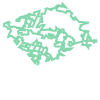

In [149]:
isochrone_approx_edge

In [8]:
def locate_farthest_intersection_point(
    center_point: Point,
    convex_hull_boundary: LineString,
    angle: float,
    raise_if_multiple: bool = False,
):
    import shapely.geometry
    import math

    ray_length = 1e5
    angle_rad = math.radians(angle)
    ray_endpoint = shapely.geometry.Point(
        center_point.x + ray_length * math.cos(angle_rad),
        center_point.y + ray_length * math.sin(angle_rad),
    )
    ray = shapely.geometry.LineString([center_point, ray_endpoint])
    intersection = convex_hull_boundary.intersection(ray)

    if intersection.is_empty:
        return None
    elif intersection.geom_type == "Point":
        return intersection
    elif intersection.geom_type in ["MultiPoint", "GeometryCollection"]:
        if raise_if_multiple:
            raise RuntimeError
        points = [geom for geom in intersection.geoms if geom.geom_type == "Point"]
        if not points:
            return None
        closest_point = max(points, key=lambda point: center_point.distance(point))
        return closest_point
    else:
        return None

In [ ]:
points = []
lines = []
for angle in np.arange(0, 360, 0.1):
    point = locate_farthest_intersection_point(center_point, isochrone_approx_edge, angle)
    if point:
        points.append(point)
        lines.append(LineString([center_point, point]))

new_boundary = Polygon(points)

m = isochrone_approx.explore(
    tiles="CartoDB Positron", color="red", style_kwds=dict(fillOpacity=0.2)
)
gpd.GeoSeries([new_boundary], crs=4326).explore(m=m, color="orange")
gpd.GeoSeries(points, crs=4326).explore(m=m)
# gpd.GeoSeries(lines, crs=4326).explore(tiles="CartoDB Positron", m=m)

In [153]:
m = gpd.GeoSeries(lines, crs=4326).explore(
    tiles="CartoDB Positron", style_kwds=dict(color="orange", opacity=0.5)
)
isochrone_approx.explore(color="red", style_kwds=dict(fillOpacity=0), m=m)
gpd.GeoSeries(points, crs=4326).explore(m=m)
gpd.GeoSeries([center_point], crs=4326).explore(m=m)

In [9]:
wroclaw_buildings = convert_geometry_to_geodataframe(
    geocode_to_geometry("Wrocław"), tags_filter={"building": True}
)
wroclaw_buildings

,building,geometry
feature_id,,
way/386385875,yes,"POLYGON ((16.96209 51.0514, 16.96205 51.05137,..."
way/100755003,yes,"POLYGON ((16.96621 51.04966, 16.9662 51.04964,..."
way/1002238761,warehouse,"POLYGON ((16.96613 51.05099, 16.9667 51.05158,..."
way/130119161,retail,"POLYGON ((16.9683 51.05166, 16.96864 51.05168,..."
way/100748391,retail,"POLYGON ((16.97417 51.05354, 16.97391 51.05353..."
...,...,...
way/100926981,yes,"POLYGON ((17.0995 51.08259, 17.09942 51.08257,..."
way/776972731,yes,"POLYGON ((17.09948 51.08241, 17.09938 51.08256..."
way/100929479,yes,"POLYGON ((17.0992 51.08238, 17.09907 51.08235,..."


In [154]:
clipped_buildings = wroclaw_buildings.clip(new_boundary).explode()
clipped_buildings = clipped_buildings[clipped_buildings.geom_type == 'Polygon']
clipped_buildings

,building,geometry
feature_id,,
way/101137663,office,"POLYGON ((17.03266 51.10533, 17.03266 51.10533..."
way/101125485,commercial,"POLYGON ((17.03275 51.10576, 17.03272 51.10563..."
way/101132097,yes,"POLYGON ((17.03269 51.10563, 17.03254 51.10566..."
way/101124731,civic,"POLYGON ((17.0329 51.10564, 17.03289 51.1056, ..."
way/101142186,yes,"POLYGON ((17.03406 51.10573, 17.03403 51.10573..."
...,...,...
way/101200853,apartments,"POLYGON ((17.03371 51.11262, 17.03367 51.11263..."
way/101207686,apartments,"POLYGON ((17.03331 51.11258, 17.03326 51.11259..."
way/101202119,apartments,"POLYGON ((17.03301 51.11264, 17.03301 51.11264..."


In [155]:
m = (
    edges_union.explode(ignore_index=True, index_parts=True)
    .reset_index()
    .explore("index", tiles="CartoDB Voyager")
)
clipped_buildings.explore(m=m)

In [10]:
from shapely import distance
from shapely.coords import CoordinateSequence


def get_bearing(lat1, long1, lat2, long2):
    dLon = long2 - long1
    x = np.cos(np.radians(lat2)) * np.sin(np.radians(dLon))
    y = np.cos(np.radians(lat1)) * np.sin(np.radians(lat2)) - np.sin(
        np.radians(lat1)
    ) * np.cos(np.radians(lat2)) * np.cos(np.radians(dLon))
    brng = np.arctan2(x, y)
    brng = np.degrees(brng)

    return brng


def get_angle(point1: Point, point2: Point):
    rads = np.arctan2(point2.y - point1.y, point2.x - point1.x)
    return np.degrees(rads)


def transform_point(
    point: Point, center_point: Point, isochrone_boundary: Polygon
) -> Point:
    angle = get_angle(center_point, point)
    intersection_point = locate_farthest_intersection_point(
        center_point, isochrone_boundary.exterior, angle
    )

    distance_from_isochrone_boundary = distance(
        center_point, intersection_point
    )
    distance_from_current_point = distance(center_point, point)
    distance_ratio = min(1, distance_from_current_point / distance_from_isochrone_boundary)

    length = distance_ratio

    angle_rad = np.radians(angle)

    new_point = Point(length * np.cos(angle_rad), length * np.sin(angle_rad))

    return new_point


def transform_coords(
    coords: CoordinateSequence, center_point: Point, isochrone_boundary: Polygon
) -> list[Point]:
    return [
        transform_point(Point(x, y), center_point, isochrone_boundary)
        for x, y in coords
    ]


def transform_geometries(
    gs: gpd.GeoSeries, center_point: Point, isochrone_boundary: Polygon
):
    geoms = []
    for geometry in gs:
        if isinstance(geometry, Polygon):
            transformed_ex = transform_coords(
                geometry.exterior.coords, center_point, isochrone_boundary
            )
            transformed_ins = [
                transform_coords(interior.coords, center_point, isochrone_boundary)
                for interior in geometry.interiors
            ]
            geoms.append(Polygon(transformed_ex, transformed_ins))
        elif isinstance(geometry, LineString):
            # print(geometry)
            transformed_coords = transform_coords(
                geometry.coords, center_point, isochrone_boundary
            )
            geoms.append(LineString(transformed_coords))

    return gpd.GeoSeries(geoms)


# transformed_buildings = transform_geometries(
#     clipped_buildings.geometry, center_point, new_boundary
# )
# transformed_edges = transform_geometries(
#     edges_union.explode(), center_point, new_boundary
# )
# transformed_edges

NameError: name 'new_boundary' is not defined

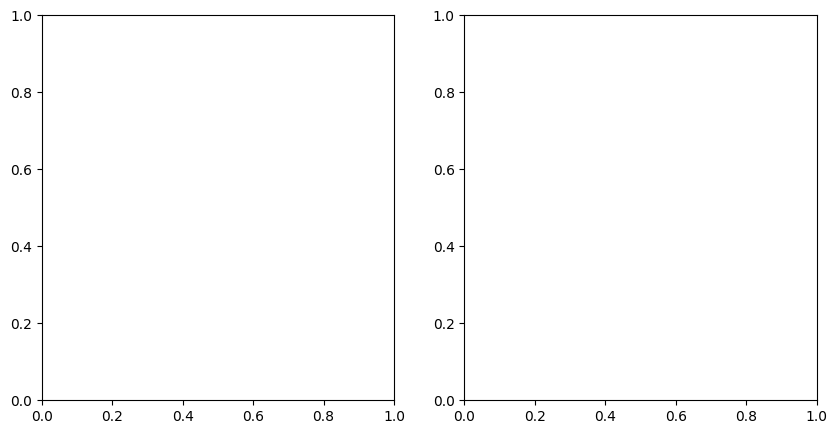

In [12]:
from matplotlib import pyplot as plt
import contextily as cx

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

gpd.GeoSeries([new_boundary], crs=4326).exterior.plot(ax=ax1, color="C3")
edges_union.plot(ax=ax1, color="C0", lw=1)
clipped_buildings.plot(ax=ax1, color="C1")
gpd.GeoSeries([center_point], crs=4326).plot(ax=ax1, color="C2")

gpd.GeoSeries([Point(0, 0).buffer(1)]).exterior.plot(ax=ax2, color="C3")
transformed_edges.plot(ax=ax2, color="C0", lw=1)
transformed_buildings.plot(ax=ax2, color="C1")
gpd.GeoSeries([Point(0, 0)]).plot(ax=ax2, color="C2")

ax1.set_axis_off()
ax2.set_axis_off()

cx.add_basemap(ax1, source="CartoDB VoyagerNoLabels", crs=4326)

ax1.set_title("Geographic isochrone")
ax2.set_title("Chronographic isochrone")

plt.tight_layout()

plt.show()

### Combine all

In [11]:
DISTANCE_M = 100

In [12]:
clipped_edges = truncate_osmnx_graph(g_walk, center_point, DISTANCE_M)
edges_union = gpd.GeoSeries([clipped_edges.union_all()], crs=4326)
clipped_edges

/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0      LINESTRING (17.03338 51.10875, 17.03334 51.1086)
1     LINESTRING (17.03338 51.10875, 17.03342 51.10873)
2     LINESTRING (17.03338 51.10875, 17.03334 51.108...
3      LINESTRING (17.03286 51.10912, 17.0328 51.10913)
4     LINESTRING (17.03286 51.10912, 17.03288 51.10911)
                            ...                        
82    LINESTRING (17.03253 51.10831, 17.03248 51.108...
83     LINESTRING (17.03281 51.10971, 17.0329 51.10985)
84     LINESTRING (17.0328 51.10913, 17.03151 51.10939)
85    LINESTRING (17.03273 51.10974, 17.03279 51.10982)
86    LINESTRING (17.03273 51.10974, 17.03268 51.109...
Length: 87, dtype: geometry

In [14]:
hull_ratio = 0.0
finished = False
while not finished:
    try:
        isochrone_approx = edges_union.concave_hull(ratio=hull_ratio)
        isochrone_approx_edge = isochrone_approx.boundary.iloc[0]

        points = []
        lines = []
        for angle in np.arange(0, 360, 0.1):
            point = locate_farthest_intersection_point(
                center_point, isochrone_approx_edge, angle, raise_if_multiple=True
            )
            if point:
                points.append(point)
                lines.append(LineString([center_point, point]))

        new_boundary = Polygon(points)
        finished = True
    except RuntimeError:
        hull_ratio += 0.01

print(hull_ratio)

0.5300000000000002


In [15]:
m = isochrone_approx.explore(
    tiles="CartoDB Positron", color="red", style_kwds=dict(fillOpacity=0.2)
)

gpd.GeoSeries([new_boundary], crs=4326).explore(m=m, color="orange")
edges_union.explore(m=m, color="black")
gpd.GeoSeries(points, crs=4326).explore(m=m)

In [16]:
clipped_buildings = wroclaw_buildings.clip(new_boundary).explode()
clipped_buildings = clipped_buildings[clipped_buildings.geom_type == 'Polygon']

transformed_buildings = transform_geometries(
    clipped_buildings.geometry, center_point, new_boundary
)
transformed_edges = transform_geometries(
    edges_union.explode(), center_point, new_boundary
)

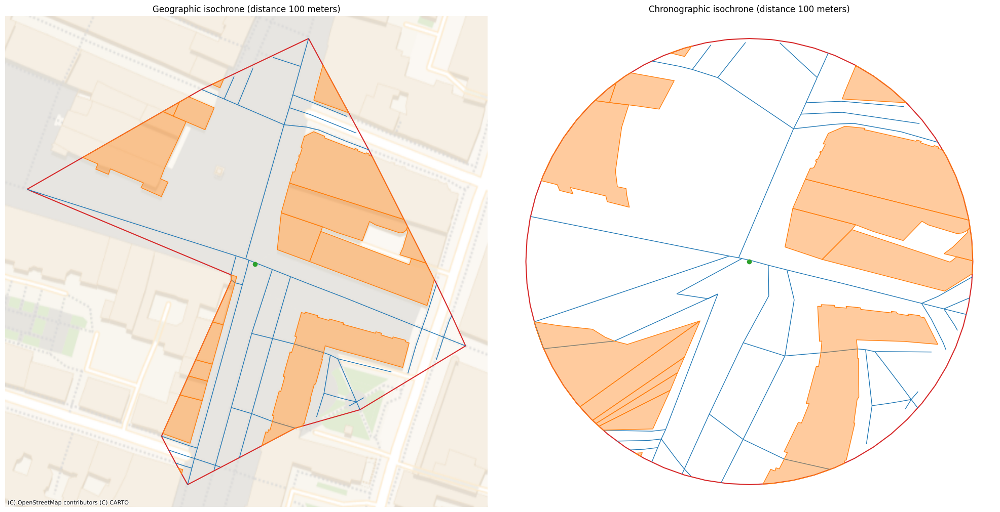

In [17]:
from matplotlib import pyplot as plt
import contextily as cx

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

###

gpd.GeoSeries([new_boundary], crs=4326).exterior.plot(ax=ax1, color="C3", zorder=1)
edges_union.plot(ax=ax1, color="C0", lw=1, zorder=2)
# clipped_buildings.plot(
#     ax=ax1, color=(0, 0, 0, 0), hatch="///", edgecolor="C1", linewidth=0.5, zorder=2
# )
clipped_buildings.plot(ax=ax1, color="C1", alpha=0.4, zorder=3)
clipped_buildings.boundary.plot(ax=ax1, color="C1", lw=1, zorder=4)
gpd.GeoSeries([center_point], crs=4326).plot(ax=ax1, color="C2", zorder=5)

###

gpd.GeoSeries([Point(0, 0).buffer(1)]).exterior.plot(ax=ax2, color="C3", zorder=1)
transformed_edges.plot(ax=ax2, color="C0", lw=1, zorder=2)
# transformed_buildings.plot(ax=ax2, color="C1")
# transformed_buildings.plot(
#     ax=ax2, color=(0, 0, 0, 0), hatch="///", edgecolor="C1", linewidth=0.5, zorder=2
# )
transformed_buildings.plot(ax=ax2, color="C1", alpha=0.4, zorder=3)
transformed_buildings.boundary.plot(ax=ax2, color="C1", lw=1, zorder=3)
gpd.GeoSeries([Point(0, 0)]).plot(ax=ax2, color="C2", zorder=4)

###

ax1.set_axis_off()
ax2.set_axis_off()

cx.add_basemap(ax1, source="CartoDB VoyagerNoLabels", crs=4326)

ax1.set_title(f"Geographic isochrone (distance {DISTANCE_M} meters)")
ax2.set_title(f"Chronographic isochrone (distance {DISTANCE_M} meters)")

plt.tight_layout()

plt.show()

In [41]:
def generate_isochrone_data(distance_m: float, transform: bool = True):
    clipped_edges = truncate_osmnx_graph(g_walk, center_point, distance_m)
    edges_union = gpd.GeoSeries([clipped_edges.union_all()], crs=4326)

    hull_ratio = 0.05
    finished = False
    while not finished:
        try:
            isochrone_approx = edges_union.concave_hull(ratio=hull_ratio)
            isochrone_approx_edge = isochrone_approx.boundary.iloc[0]

            points = []
            lines = []
            for angle in np.arange(0, 360, 0.1):
                point = locate_farthest_intersection_point(
                    center_point, isochrone_approx_edge, angle, raise_if_multiple=True
                )
                if point:
                    points.append(point)
                    lines.append(LineString([center_point, point]))

            isochrone_boundary = Polygon(points)
            finished = True
        except RuntimeError:
            hull_ratio += 0.01

    print(hull_ratio)

    clipped_buildings = wroclaw_buildings.clip(isochrone_boundary).explode()
    clipped_buildings = clipped_buildings[clipped_buildings.geom_type == 'Polygon']

    if not transform:
        return isochrone_boundary, clipped_buildings, edges_union

    transformed_buildings = transform_geometries(
        clipped_buildings.geometry, center_point, isochrone_boundary
    )
    transformed_edges = transform_geometries(
        edges_union.explode(), center_point, isochrone_boundary
    )

    return isochrone_boundary, clipped_buildings, edges_union, transformed_buildings, transformed_edges

In [19]:
isochrone_boundary_100, clipped_buildings_100, edges_union_100, transformed_buildings_100, transformed_edges_100 = generate_isochrone_data(100)

/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.5300000000000002


In [20]:
isochrone_boundary_200, clipped_buildings_200, edges_union_200, transformed_buildings_200, transformed_edges_200 = generate_isochrone_data(200)

/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.37000000000000016


In [65]:
isochrone_boundary_500, clipped_buildings_500, edges_union_500, transformed_buildings_500, transformed_edges_500 = generate_isochrone_data(500)

/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.4400000000000002


TypeError: transform_geometries() missing 1 required positional argument: 'isochrone_boundary_close'

In [21]:
def plot_data(
    isochrone_boundary, buildings, edges, transformed_buildings, transformed_edges, distance
):
    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

    ###

    gpd.GeoSeries([isochrone_boundary], crs=4326).exterior.plot(ax=ax1, color="C3", zorder=1)
    edges.plot(ax=ax1, color="C0", lw=1, zorder=2)
    buildings.plot(ax=ax1, color="C1", alpha=0.4, zorder=3)
    buildings.boundary.plot(ax=ax1, color="C1", lw=1, zorder=4)
    gpd.GeoSeries([center_point], crs=4326).plot(ax=ax1, color="C2", zorder=5)

    ###

    gpd.GeoSeries([Point(0, 0).buffer(1)]).exterior.plot(ax=ax2, color="C3", zorder=1)
    transformed_edges.plot(ax=ax2, color="C0", lw=1, zorder=2)
    transformed_buildings.plot(ax=ax2, color="C1", alpha=0.4, zorder=3)
    transformed_buildings.boundary.plot(ax=ax2, color="C1", lw=1, zorder=3)
    gpd.GeoSeries([Point(0, 0)]).plot(ax=ax2, color="C2", zorder=4)

    ###

    ax1.set_axis_off()
    ax2.set_axis_off()

    cx.add_basemap(ax1, source="CartoDB VoyagerNoLabels", crs=4326)

    ax1.set_title(f"Geographic isochrone (distance {distance} meters)")
    ax2.set_title(f"Chronographic isochrone (distance {distance} meters)")

    plt.tight_layout()

    plt.show()

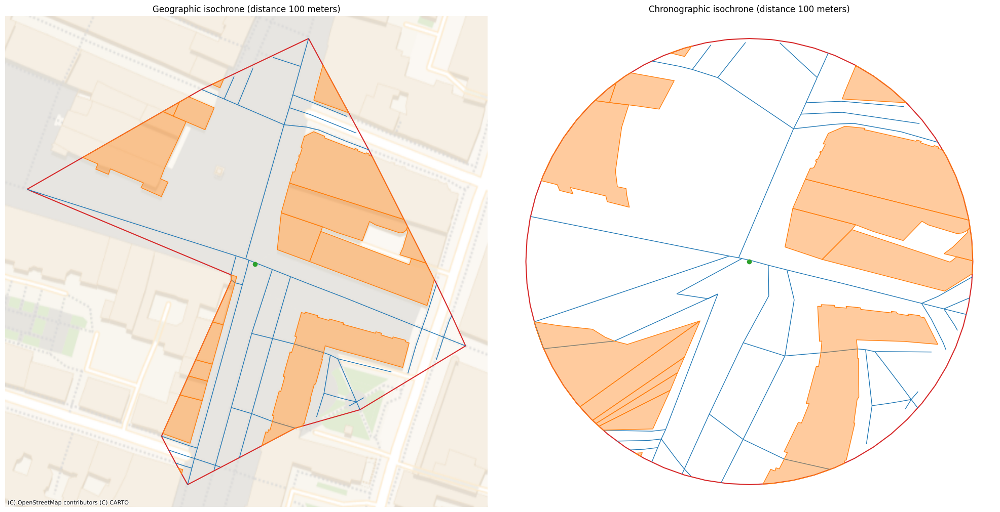

In [22]:
plot_data(isochrone_boundary_100, clipped_buildings_100, edges_union_100, transformed_buildings_100, transformed_edges_100, 100)

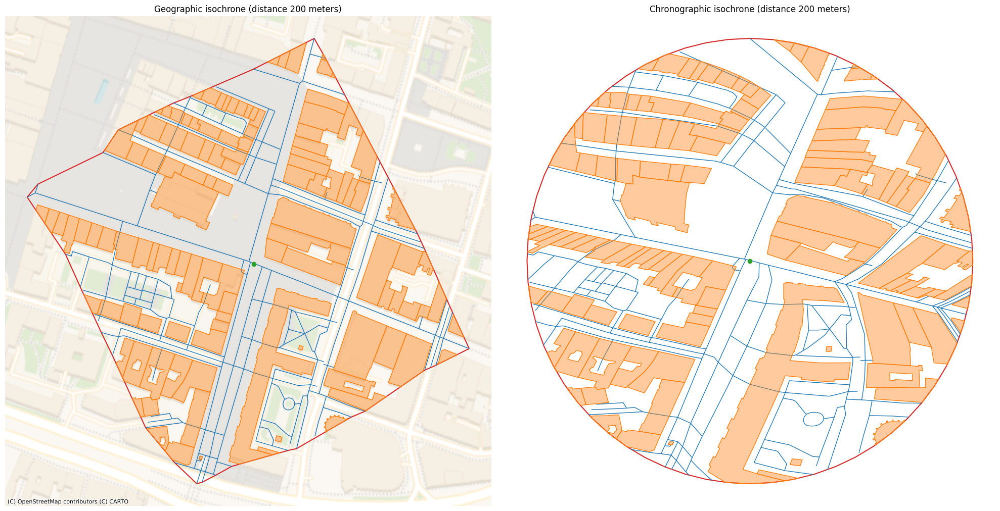

In [23]:
plot_data(isochrone_boundary_200, clipped_buildings_200, edges_union_200, transformed_buildings_200, transformed_edges_200, 200)

In [24]:
clipped_buildings_200_without_100 = clipped_buildings_200.difference(isochrone_boundary_100)
clipped_buildings_200_without_100

feature_id
way/385684045       POLYGON ((17.03228 51.1076, 17.03227 51.1076, ...
way/101143226       POLYGON ((17.03214 51.10757, 17.0321 51.10756,...
relation/1442221    POLYGON ((17.03163 51.10784, 17.03168 51.10784...
way/101124739       POLYGON ((17.03219 51.10808, 17.03218 51.10809...
way/101144850       POLYGON ((17.03159 51.10793, 17.03154 51.10793...
                                          ...                        
way/101194588       POLYGON ((17.03381 51.11013, 17.0338 51.11014,...
way/101197959       POLYGON ((17.03402 51.11024, 17.03393 51.11026...
way/101192608       POLYGON ((17.03391 51.11052, 17.03386 51.11053...
way/101200451       POLYGON ((17.03381 51.11065, 17.03381 51.11065...
way/101195747       POLYGON ((17.03375 51.11068, 17.03376 51.11071...
Length: 119, dtype: geometry

In [25]:
m = gpd.GeoSeries(
    [isochrone_boundary_100, isochrone_boundary_200], crs=4326
).boundary.explore(tiles="CartoDB Voyager")
clipped_buildings_200_without_100.explore(m=m, color="red")
clipped_buildings_100.explore(m=m, color="orange")
m

In [70]:
# interpolate between isochrones

from shapely import distance
from shapely.coords import CoordinateSequence


def transform_point_between_isochrones(
    point: Point,
    center_point: Point,
    isochrone_boundary_far: Polygon,
    isochrone_boundary_close: Polygon | None,
    vector_start=0.0,
    vector_length=1.0,
) -> Point:
    angle = get_angle(center_point, point)
    intersection_point = locate_farthest_intersection_point(
        center_point, isochrone_boundary_far.exterior, angle
    )
    distance_from_far_isochrone_boundary = distance(center_point, intersection_point)
    distance_from_current_point = distance(center_point, point)

    if isochrone_boundary_close is None:
        distance_ratio = min(
            1, distance_from_current_point / distance_from_far_isochrone_boundary
        )
    else:
        close_intersection_point = locate_farthest_intersection_point(
            center_point, isochrone_boundary_close.exterior, angle
        )
        distance_from_close_isochrone_boundary = distance(
            center_point, close_intersection_point
        )
        distance_ratio = min(
            1,
            (distance_from_current_point - distance_from_close_isochrone_boundary)
            / (
                distance_from_far_isochrone_boundary
                - distance_from_close_isochrone_boundary
            ),
        )

    length = vector_length * distance_ratio + vector_start

    angle_rad = np.radians(angle)

    new_point = Point(length * np.cos(angle_rad), length * np.sin(angle_rad))

    return new_point


def transform_coords(
    coords: CoordinateSequence,
    center_point: Point,
    isochrone_boundary_far: Polygon,
    isochrone_boundary_close: Polygon | None,
    vector_start=0.0,
    vector_length=1.0,
) -> list[Point]:
    return [
        transform_point_between_isochrones(
            Point(x, y),
            center_point,
            isochrone_boundary_far,
            isochrone_boundary_close,
            vector_start,
            vector_length,
        )
        for x, y in coords
    ]


def transform_geometries(
    gs: gpd.GeoSeries,
    center_point: Point,
    isochrone_boundary_far: Polygon,
    isochrone_boundary_close: Polygon | None,
    vector_start=0.0,
    vector_length=1.0,
):
    geoms = []
    for geometry in gs:
        if isinstance(geometry, Polygon):
            transformed_ex = transform_coords(
                geometry.exterior.coords,
                center_point,
                isochrone_boundary_far,
                isochrone_boundary_close,
                vector_start,
                vector_length,
            )
            transformed_ins = [
                transform_coords(
                    interior.coords,
                    center_point,
                    isochrone_boundary_far,
                    isochrone_boundary_close,
                    vector_start,
                    vector_length,
                )
                for interior in geometry.interiors
            ]
            geoms.append(Polygon(transformed_ex, transformed_ins))
        elif isinstance(geometry, LineString):
            transformed_coords = transform_coords(
                geometry.coords,
                center_point,
                isochrone_boundary_far,
                isochrone_boundary_close,
                vector_start,
                vector_length,
            )
            geoms.append(LineString(transformed_coords))

    return gpd.GeoSeries(geoms)

In [35]:
transformed_buildings_100_new = transform_geometries(
    clipped_buildings_100.geometry,
    center_point=center_point,
    isochrone_boundary_far=isochrone_boundary_100,
    isochrone_boundary_close=None,
    vector_start=0,
)
transformed_buildings_100_new

0     POLYGON ((0.09558 -0.93137, 0.11472 -0.93867, ...
1     POLYGON ((-0.43206 -0.75046, -0.65486 -0.75575...
2     POLYGON ((-0.32125 -0.49819, -0.35408 -0.57707...
3     POLYGON ((-0.29061 -0.42852, -0.32125 -0.49819...
4     POLYGON ((-0.29061 -0.42852, -0.70196 -0.71222...
5     POLYGON ((-0.70193 -0.30345, -0.64548 -0.33882...
6     POLYGON ((-0.47893 -0.85689, -0.48629 -0.8738,...
7     POLYGON ((0.92829 0.02132, 0.87072 0.0352, 0.9...
8     POLYGON ((0.91306 0.00926, 0.92829 0.02132, 0....
9     POLYGON ((0.45873 0.14322, 0.32575 0.00949, 0....
10    POLYGON ((0.98271 0.18514, 0.98294 0.18395, 0....
11    POLYGON ((0.51389 0.59072, 0.52648 0.58904, 0....
12    POLYGON ((-0.40353 0.68336, -0.49437 0.69654, ...
13    POLYGON ((-0.6256 0.71274, -0.69216 0.72174, -...
14    POLYGON ((0.41562 0.72881, 0.42891 0.76461, 0....
15    POLYGON ((-0.28982 0.91938, -0.35401 0.93524, ...
16    POLYGON ((-0.6256 0.71274, -0.53979 0.7023, -0...
17    POLYGON ((0.47447 0.87357, 0.47686 0.87898

In [36]:
transformed_buildings_200_new = transform_geometries(
    clipped_buildings_200.difference(isochrone_boundary_100),
    # clipped_buildings_200.geometry,
    center_point=center_point,
    isochrone_boundary_far=isochrone_boundary_200,
    isochrone_boundary_close=isochrone_boundary_100,
    vector_start=1,
)
transformed_buildings_200_new

0      POLYGON ((-0.69864 -1.65349, -0.70953 -1.6514,...
1      POLYGON ((-0.85659 -1.69358, -0.9012 -1.70924,...
2      POLYGON ((-1.41952 -1.3948, -1.375 -1.40072, -...
3      POLYGON ((-0.80921 -1.13018, -0.81647 -1.12925...
4      POLYGON ((-1.4826 -1.30138, -1.52253 -1.29688,...
                             ...                        
114    POLYGON ((1.06197 1.224, 1.0505 1.22527, 1.044...
115    POLYGON ((1.3123 1.35403, 1.20007 1.37133, 1.1...
116    POLYGON ((1.13967 1.63475, 1.08032 1.63418, 1....
117    POLYGON ((0.99395 1.73553, 0.99698 1.73379, 1 ...
118    POLYGON ((0.91698 1.74193, 0.92831 1.77151, 0....
Length: 119, dtype: geometry

<Axes: >

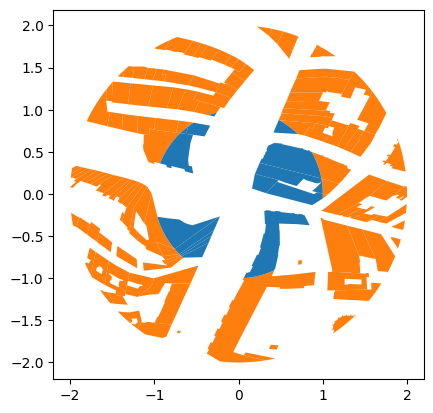

In [38]:
ax = transformed_buildings_200_new.plot(color='C1')
transformed_buildings_100_new.plot(ax=ax, color='C0')

In [42]:
distances = [100, 200, 300, 400, 500]
isochrones = []
buildings = []
edges = []

for distance_m in distances:
    _isochrone_boundary, _clipped_buildings, _edges_union = generate_isochrone_data(distance_m, transform=False)
    isochrones.append(_isochrone_boundary)
    buildings.append(_clipped_buildings)
    edges.append(_edges_union)

/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.5300000000000002


/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.37000000000000016


/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.3900000000000002


/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.2700000000000001


/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.4400000000000002


In [43]:
m = gpd.GeoSeries(
    isochrones, crs=4326
).boundary.explore(tiles="CartoDB Voyager")
# clipped_buildings_200_without_100.explore(m=m, color="red")
# clipped_buildings_100.explore(m=m, color="orange")
m

In [63]:
transformed_buildings = []
transformed_edges = []

for _i in range(len(isochrones) - 1, -1, -1):
    print(_i)
    isochrone_far = isochrones[_i]
    isochrone_close = isochrones[_i - 1] if _i > 0 else None

    clipped_buildings = buildings[_i]
    clipped_edges = edges[_i]

    print(
        clipped_buildings.difference(isochrone_close)
        if isochrone_close is not None
        else clipped_buildings
    )

    _transformed_buildings = transform_geometries(
        clipped_buildings.difference(isochrone_close)
        if isochrone_close is not None
        else clipped_buildings.geometry,
        center_point=center_point,
        isochrone_boundary_far=isochrone_far,
        isochrone_boundary_close=isochrone_close,
        vector_start=_i,
    )

    print(_transformed_buildings)

    _transformed_edges = transform_geometries(
        clipped_edges.difference(isochrone_close)
        if isochrone_close is not None
        else clipped_edges.geometry,
        center_point=center_point,
        isochrone_boundary_far=isochrone_far,
        isochrone_boundary_close=isochrone_close,
        vector_start=_i,
    )

    transformed_buildings.append(_transformed_buildings)
    transformed_edges.append(_transformed_edges)

# for _isochrone_boundary, _clipped_buildings, _edges_union in enumerate(zip(isochrones, buildings, edges):


4
feature_id
way/101137663     POLYGON ((17.03265 51.10528, 17.03265 51.10526...
way/101125485     POLYGON ((17.03272 51.10563, 17.03269 51.10563...
way/101132097     POLYGON ((17.03254 51.10566, 17.03253 51.10565...
way/101124731     POLYGON ((17.03289 51.1056, 17.03288 51.10561,...
way/1005012894    POLYGON ((17.03486 51.10605, 17.03486 51.10605...
                                        ...                        
way/101215533     POLYGON ((17.03279 51.11275, 17.0328 51.11275,...
way/1074848360    POLYGON ((17.03345 51.11294, 17.03344 51.11292...
way/101202091     POLYGON ((17.03285 51.11283, 17.03284 51.11281...
way/101188462     POLYGON ((17.03452 51.11315, 17.03439 51.11317...
way/1074848365    POLYGON ((17.03383 51.11302, 17.03378 51.11303...
Length: 545, dtype: geometry
0      POLYGON ((-0.34161 -4.96543, -0.34673 -4.98796...
1      POLYGON ((-0.25624 -4.5313, -0.28879 -4.51664,...
2      POLYGON ((-0.48703 -4.42399, -0.48938 -4.42999...
3      POLYGON ((-0.0357 -4.62678, -0.0

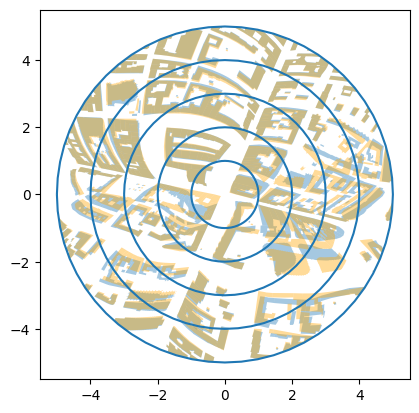

In [74]:
ax = None
for _b in transformed_buildings:
    ax = _b.plot(ax=ax, alpha=0.4)

transform_geometries(
    buildings[-1].geometry,
    center_point=center_point,
    isochrone_boundary_far=isochrones[-1],
    isochrone_boundary_close=None,
    vector_start=0,
    vector_length=5,
).plot(ax=ax, alpha=0.4, color="orange")

gpd.GeoSeries(
    [Point(0, 0).buffer(_i + 1) for _i in range(len(isochrones))]
).boundary.plot(ax=ax)

plt.show()

<Axes: >

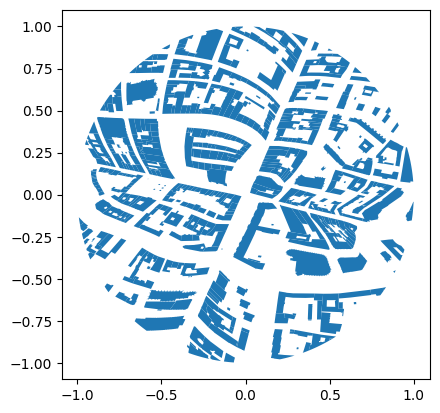

In [67]:
transform_geometries(
    buildings[-1].geometry,
    center_point=center_point,
    isochrone_boundary_far=isochrones[-1],
    isochrone_boundary_close=None,
    vector_start=0,
).plot()

In [75]:
distances = [500, 1000, 1500]
isochrones = []
buildings = []
edges = []

for distance_m in distances:
    _isochrone_boundary, _clipped_buildings, _edges_union = generate_isochrone_data(distance_m, transform=False)
    isochrones.append(_isochrone_boundary)
    buildings.append(_clipped_buildings)
    edges.append(_edges_union)

/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.4400000000000002


/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.13999999999999999


/tmp/ipykernel_1175/1442769862.py:106: PerformanceWarning: indexing past lexsort depth may impact performance.
  edge = pruned_edges.loc[(u, v)].iloc[0]


0.23000000000000007


In [76]:
m = gpd.GeoSeries(
    isochrones, crs=4326
).boundary.explore(tiles="CartoDB Voyager")
# clipped_buildings_200_without_100.explore(m=m, color="red")
# clipped_buildings_100.explore(m=m, color="orange")
m

In [77]:
transformed_buildings = []
transformed_edges = []

for _i in range(len(isochrones) - 1, -1, -1):
    isochrone_far = isochrones[_i]
    isochrone_close = isochrones[_i - 1] if _i > 0 else None

    clipped_buildings = buildings[_i]
    clipped_edges = edges[_i]

    _transformed_buildings = transform_geometries(
        clipped_buildings.difference(isochrone_close)
        if isochrone_close is not None
        else clipped_buildings.geometry,
        center_point=center_point,
        isochrone_boundary_far=isochrone_far,
        isochrone_boundary_close=isochrone_close,
        vector_start=_i,
    )

    _transformed_edges = transform_geometries(
        clipped_edges.difference(isochrone_close)
        if isochrone_close is not None
        else clipped_edges.geometry,
        center_point=center_point,
        isochrone_boundary_far=isochrone_far,
        isochrone_boundary_close=isochrone_close,
        vector_start=_i,
    )

    transformed_buildings.append(_transformed_buildings)
    transformed_edges.append(_transformed_edges)


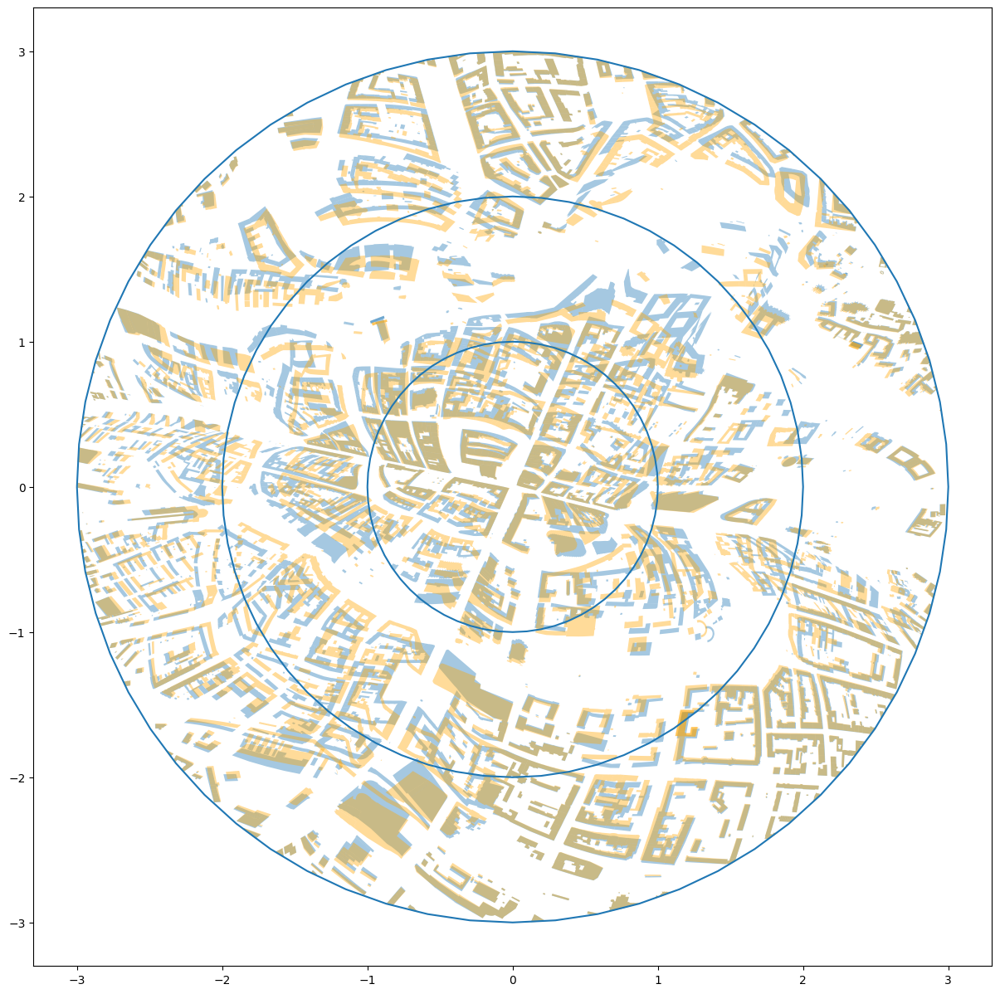

In [81]:
fig, ax = plt.subplots(figsize=(15, 15))
for _b in transformed_buildings:
    ax = _b.plot(ax=ax, alpha=0.4)

transform_geometries(
    buildings[-1].geometry,
    center_point=center_point,
    isochrone_boundary_far=isochrones[-1],
    isochrone_boundary_close=None,
    vector_start=0,
    vector_length=len(isochrones),
).plot(ax=ax, alpha=0.4, color="orange")

gpd.GeoSeries(
    [Point(0, 0).buffer(_i + 1) for _i in range(len(isochrones))]
).boundary.plot(ax=ax)

plt.show()